# Deep Learning Regression Analysis House Price Prediction

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('ggplot')
from warnings import filterwarnings
filterwarnings('ignore')

In [6]:
df = pd.read_csv('kc_house_data.csv')

## Exploratory Data Analysis

In [7]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [8]:
df.shape

(21597, 21)

In [9]:
df.isnull().sum()

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [10]:
pd.set_option('display.float_format', lambda x: '%.3f' % x)

In [11]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,21597.000,4580474287.771,2876735715.748,1000102.000,2123049175.000,3904930410.000,7308900490.000,9900000190.000
price,21597.000,540296.574,367368.140,78000.000,322000.000,450000.000,645000.000,7700000.000
bedrooms,21597.000,3.373,0.926,1.000,3.000,3.000,4.000,33.000
bathrooms,21597.000,2.116,0.769,0.500,1.750,2.250,2.500,8.000
sqft_living,21597.000,2080.322,918.106,370.000,1430.000,1910.000,2550.000,13540.000
sqft_lot,21597.000,15099.409,41412.637,520.000,5040.000,7618.000,10685.000,1651359.000
floors,21597.000,1.494,0.540,1.000,1.000,1.500,2.000,3.500
waterfront,21597.000,0.008,0.087,0.000,0.000,0.000,0.000,1.000
view,21597.000,0.234,0.766,0.000,0.000,0.000,0.000,4.000
condition,21597.000,3.410,0.651,1.000,3.000,3.000,4.000,5.000


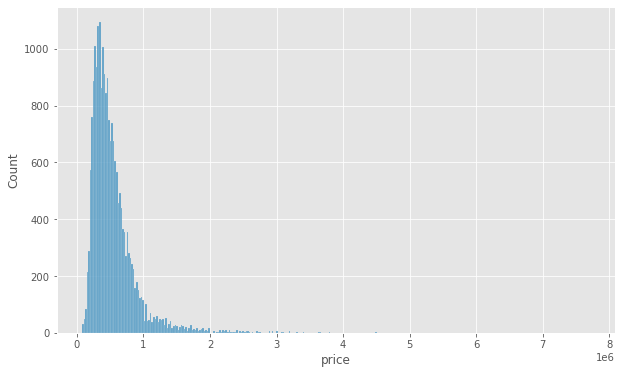

In [12]:
# Histogram of Price column
plt.figure(figsize=(10,6))
sns.histplot(df['price']);

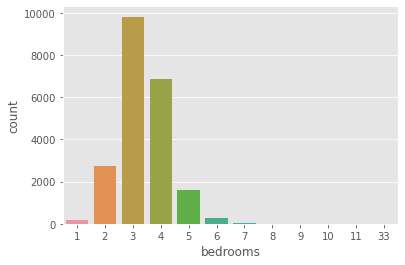

In [13]:
sns.countplot(df['bedrooms']);

In [14]:
df.corr()['price'].sort_values(ascending=False)

price            1.000
sqft_living      0.702
grade            0.668
sqft_above       0.605
sqft_living15    0.585
bathrooms        0.526
view             0.397
sqft_basement    0.324
bedrooms         0.309
lat              0.307
waterfront       0.266
floors           0.257
yr_renovated     0.126
sqft_lot         0.090
sqft_lot15       0.083
yr_built         0.054
condition        0.036
long             0.022
id              -0.017
zipcode         -0.053
Name: price, dtype: float64

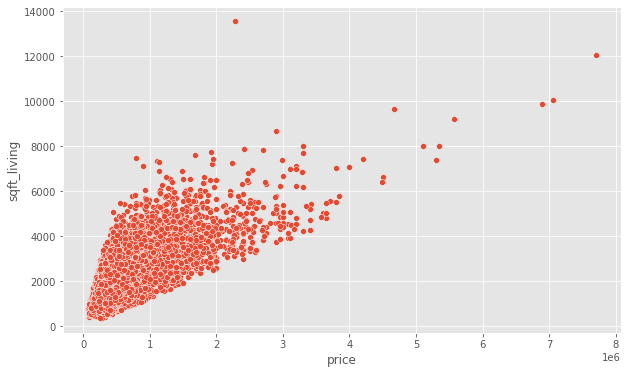

In [15]:
plt.figure(figsize=(10,6))
sns.scatterplot(x='price', y='sqft_living', data=df);

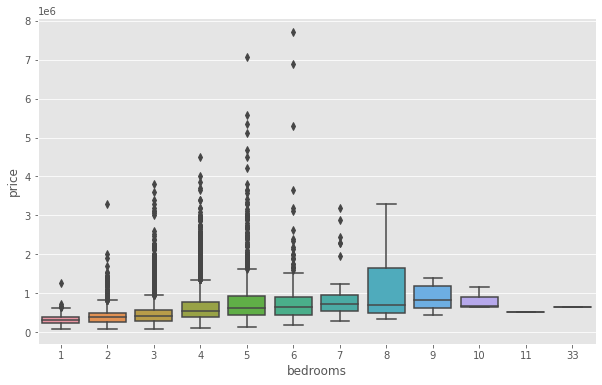

In [16]:
plt.figure(figsize=(10,6))
sns.boxplot(x='bedrooms', y='price', data=df);

In [17]:
df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

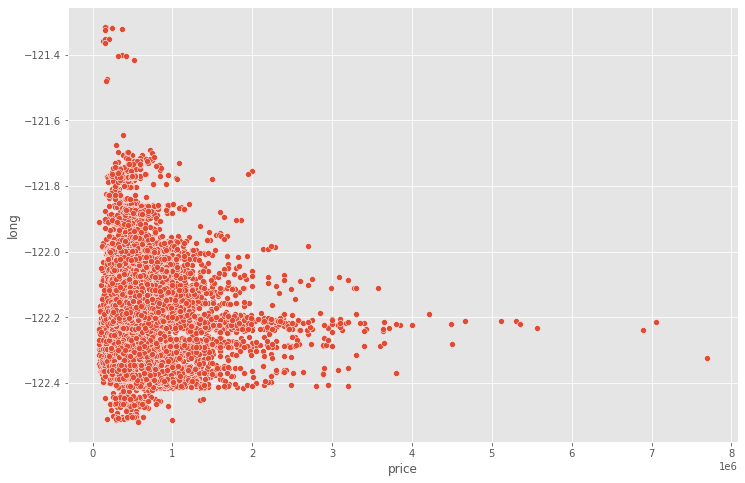

In [18]:
# Plotting price by longitute
plt.figure(figsize=(12,8))
sns.scatterplot(x='price', y='long', data=df);

_Around longitute -122.2 house prices increase. It seems that's an expensive housing area_

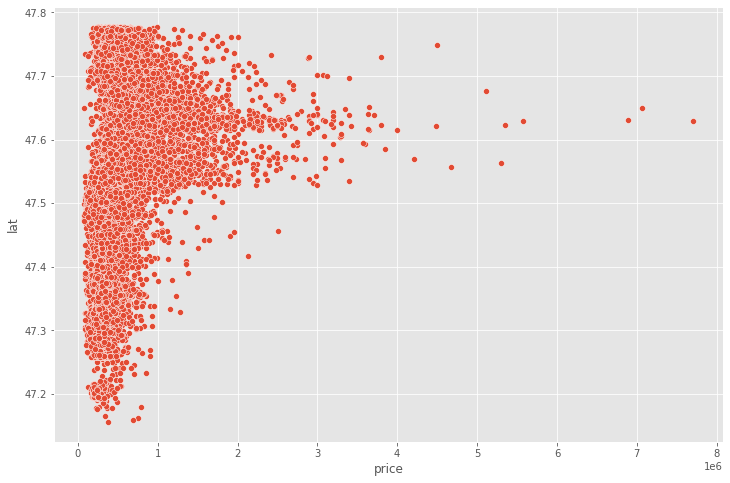

In [19]:
# Plotting price by latitude
plt.figure(figsize=(12,8))
sns.scatterplot(x='price', y='lat', data=df);

_Around latitute 46.6 house prices increase. It seems that's an expensive housing area_

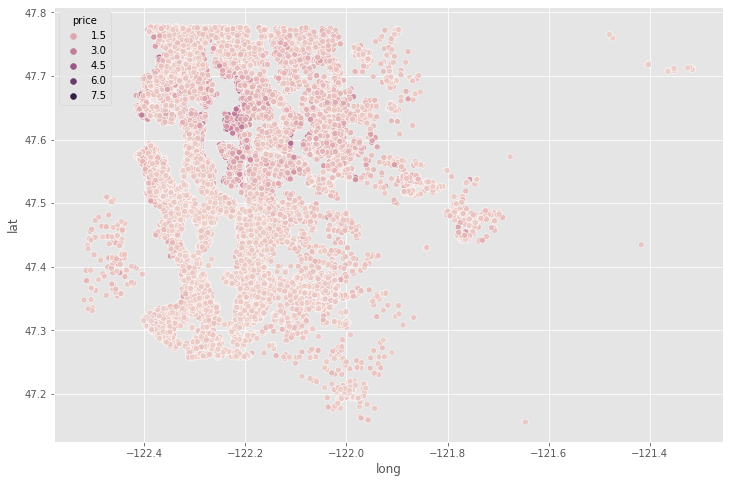

In [20]:
# Plotting lattitude and longitute
plt.figure(figsize=(12,8))
sns.scatterplot(x='long', y='lat', data=df, hue='price');

_Output is almost like map of King County. Darker color shows expensive area_

_Plotting map of King County_

In [3]:
import folium
folium.Map(location=[47.511,  -122.257], zoom_start=10)

In [29]:
map_kc = folium.Map(location=[47.511,  -122.257], zoom_start=10)

for lat, lng in zip(df['lat'], df['long']):
    folium.CircleMarker(
        [lat, lng],
        radius=1,
        color='blue',
        fill=False,
        #fill_color='#3186cc',
        fill_opacity=0.3).add_to(map_kc)  
    
map_kc

_Plotting data on map, coloring based on price_

In [43]:
import branca.colormap as cm
colormap = cm.LinearColormap(colors=['yellow','red'], index=[df['price'].min(),df['price'].max()],vmin=df['price'].min(),vmax=df['price'].max())

map_kc = folium.Map(location=[47.511,  -122.257], zoom_start=10)

for lat, lng,p in zip(df['lat'], df['long'], df['price']):
    label = '{}'.format(p)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=1,
        popup=label,
        color=colormap(p),
        fill=False,
        fill_opacity=0.3).add_to(map_kc)  
    
map_kc

In [17]:
df.sort_values('price', ascending=False).head(20)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
7245,6762700020,10/13/2014,7700000.0,6,8.00,12050,27600,2.5,0,3,...,13,8570,3480,1910,1987,98102,47.6298,-122.323,3940,8800
3910,9808700762,6/11/2014,7060000.0,5,4.50,10040,37325,2.0,1,2,...,11,7680,2360,1940,2001,98004,47.6500,-122.214,3930,25449
9245,9208900037,9/19/2014,6890000.0,6,7.75,9890,31374,2.0,0,4,...,13,8860,1030,2001,0,98039,47.6305,-122.240,4540,42730
4407,2470100110,8/4/2014,5570000.0,5,5.75,9200,35069,2.0,0,0,...,13,6200,3000,2001,0,98039,47.6289,-122.233,3560,24345
1446,8907500070,4/13/2015,5350000.0,5,5.00,8000,23985,2.0,0,4,...,12,6720,1280,2009,0,98004,47.6232,-122.220,4600,21750
1313,7558700030,4/13/2015,5300000.0,6,6.00,7390,24829,2.0,1,4,...,12,5000,2390,1991,0,98040,47.5631,-122.210,4320,24619
1162,1247600105,10/20/2014,5110000.0,5,5.25,8010,45517,2.0,1,4,...,12,5990,2020,1999,0,98033,47.6767,-122.211,3430,26788
8085,1924059029,6/17/2014,4670000.0,5,6.75,9640,13068,1.0,1,4,...,12,4820,4820,1983,2009,98040,47.5570,-122.210,3270,10454
2624,7738500731,8/15/2014,4500000.0,5,5.50,6640,40014,2.0,1,4,...,12,6350,290,2004,0,98155,47.7493,-122.280,3030,23408
8629,3835500195,6/18/2014,4490000.0,4,3.00,6430,27517,2.0,0,0,...,12,6430,0,2001,0,98004,47.6208,-122.219,3720,14592


_There are only around 20 houses with the price more than 3 million._

In [18]:
len(df)*0.01

215.97

#### Getting rid of top % 1 of data, with top price

In [19]:
non_top_1_per = df.sort_values('price', ascending=False).iloc[216:]

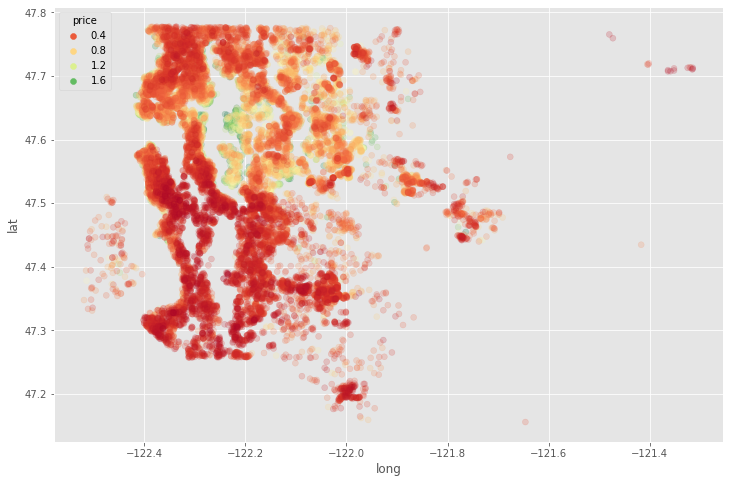

In [20]:
# Plotting lattitude and longitute
plt.figure(figsize=(12,8))
sns.scatterplot(x='long', y='lat', data=non_top_1_per, hue='price',
               edgecolor=None, alpha=0.2, palette='RdYlGn');

_Now color distribution is more distinctive. Light Color areas are the expensive ones_

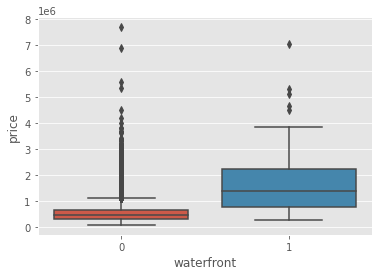

In [21]:
# Boxplot waterfront, price
sns.boxplot(x='waterfront', y='price', data=df);

_If the house is on the waterfront, it's more likely to be more expensive_

## Feature Engineering

In [31]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.000,3,1.000,1180,5650,1.000,0,0,...,7,1180,0,1955,0,98178,47.511,-122.257,1340,5650
1,6414100192,12/9/2014,538000.000,3,2.250,2570,7242,2.000,0,0,...,7,2170,400,1951,1991,98125,47.721,-122.319,1690,7639
2,5631500400,2/25/2015,180000.000,2,1.000,770,10000,1.000,0,0,...,6,770,0,1933,0,98028,47.738,-122.233,2720,8062
3,2487200875,12/9/2014,604000.000,4,3.000,1960,5000,1.000,0,0,...,7,1050,910,1965,0,98136,47.521,-122.393,1360,5000
4,1954400510,2/18/2015,510000.000,3,2.000,1680,8080,1.000,0,0,...,8,1680,0,1987,0,98074,47.617,-122.045,1800,7503


In [32]:
# Dropping id columns
df = df.drop('id', axis=1)

In [33]:
df['date']

0        10/13/2014
1         12/9/2014
2         2/25/2015
3         12/9/2014
4         2/18/2015
            ...    
21592     5/21/2014
21593     2/23/2015
21594     6/23/2014
21595     1/16/2015
21596    10/15/2014
Name: date, Length: 21597, dtype: object

In [34]:
# Converting date column from string to datetime data type
df['date'] = pd.to_datetime(df['date'])

In [35]:
df['date']

0       2014-10-13
1       2014-12-09
2       2015-02-25
3       2014-12-09
4       2015-02-18
           ...    
21592   2014-05-21
21593   2015-02-23
21594   2014-06-23
21595   2015-01-16
21596   2014-10-15
Name: date, Length: 21597, dtype: datetime64[ns]

In [36]:
# Creating new columns year and month
df['year'] = df['date'].apply(lambda date: date.year)
df['month'] = df['date'].apply(lambda date: date.month)

In [37]:
# Alternative code
# def year_extraction(date):
#    return date.year

In [29]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,month
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,3,...,0,1955,0,98178,47.5112,-122.257,1340,5650,2014,10
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,3,...,400,1951,1991,98125,47.7210,-122.319,1690,7639,2014,12
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,3,...,0,1933,0,98028,47.7379,-122.233,2720,8062,2015,2
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,5,...,910,1965,0,98136,47.5208,-122.393,1360,5000,2014,12
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,3,...,0,1987,0,98074,47.6168,-122.045,1800,7503,2015,2


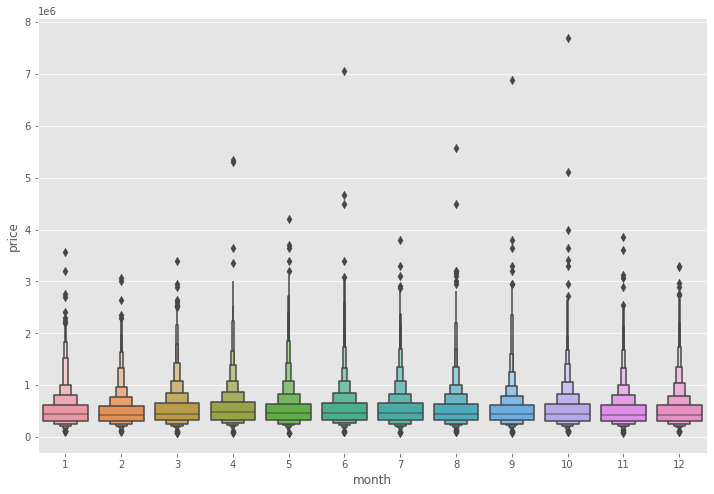

In [30]:
plt.figure(figsize=(12,8))
sns.boxenplot(x='month', y='price', data=df)

_Seems like, there's not a significant price difference between months._

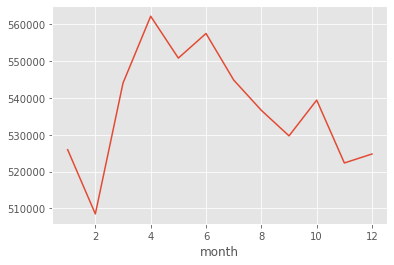

In [31]:
# Checking mean price of each month and line plot
df.groupby('month').mean()['price'].plot();

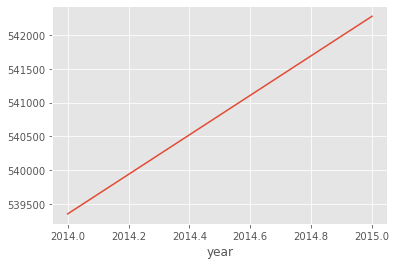

In [32]:
# Checking mean price of each year and line plot
df.groupby('year').mean()['price'].plot();

_Price increases as time goes on_

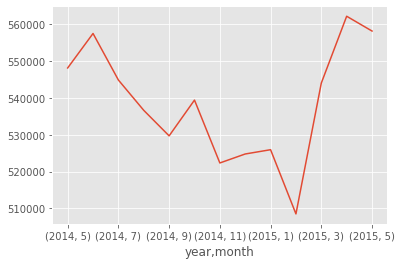

In [38]:
df.groupby(['year','month']).mean()['price'].plot()

In [33]:
# Dropping date column, no need anymore
df = df.drop('date', axis=1)

In [34]:
df.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15', 'year', 'month'],
      dtype='object')

In [35]:
df.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,month
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,...,0,1955,0,98178,47.5112,-122.257,1340,5650,2014,10
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,...,400,1951,1991,98125,47.7210,-122.319,1690,7639,2014,12
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,...,0,1933,0,98028,47.7379,-122.233,2720,8062,2015,2
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,...,910,1965,0,98136,47.5208,-122.393,1360,5000,2014,12
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,...,0,1987,0,98074,47.6168,-122.045,1800,7503,2015,2


In [36]:
df['zipcode'].value_counts()

98103    602
98038    589
98115    583
98052    574
98117    553
        ... 
98102    104
98010    100
98024     80
98148     57
98039     50
Name: zipcode, Length: 70, dtype: int64

In [37]:
df = df.drop('zipcode', axis=1)

In [38]:
df['yr_renovated'].value_counts()

0       20683
2014       91
2013       37
2003       36
2000       35
        ...  
1934        1
1959        1
1951        1
1948        1
1944        1
Name: yr_renovated, Length: 70, dtype: int64

_"0" shows the house is not renovated. For others, the higher year the better, the house will be in better condition.It's better to keep that column as is._

In [39]:
df['sqft_basement'].value_counts()

0       13110
600       221
700       218
500       214
800       206
        ...  
792         1
2590        1
935         1
2390        1
248         1
Name: sqft_basement, Length: 306, dtype: int64

## Data Prepocessing and Creating Model

In [ ]:
X = df.drop('price', axis=1).values
y = df['price'].values

In [41]:
from sklearn.model_selection import train_test_split

In [42]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

In [43]:
from sklearn.preprocessing import MinMaxScaler

In [44]:
scaler = MinMaxScaler()

In [45]:
X_train = scaler.fit_transform(X_train)

In [47]:
X_test = scaler.transform(X_test)

In [48]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

In [50]:
X_train.shape

(15117, 19)

In [51]:
model = Sequential()

model.add(Dense(19, activation='relu'))
model.add(Dense(19, activation='relu'))
model.add(Dense(19, activation='relu'))
model.add(Dense(19, activation='relu'))

model.add(Dense(1))

model.compile(optimizer='adam', loss='mse')

In [52]:
model.fit(x=X_train,y=y_train,
          validation_data=(X_test,y_test),
         batch_size=128, epochs=400)

Epoch 1/400
119/119 [==============================] - 2s 9ms/step - loss: 442804392755.2000 - val_loss: 418857189376.0000
Epoch 2/400
119/119 [==============================] - 0s 2ms/step - loss: 434280586444.8000 - val_loss: 412807266304.0000
Epoch 3/400
119/119 [==============================] - 0s 2ms/step - loss: 418207641053.8666 - val_loss: 361703309312.0000
Epoch 4/400
119/119 [==============================] - 0s 3ms/step - loss: 350633700283.7333 - val_loss: 212582612992.0000
Epoch 5/400
119/119 [==============================] - 0s 3ms/step - loss: 189008306176.0000 - val_loss: 100894728192.0000
Epoch 6/400
119/119 [==============================] - 0s 2ms/step - loss: 99231519607.4667 - val_loss: 94080147456.0000
Epoch 7/400
119/119 [==============================] - 0s 2ms/step - loss: 103742501137.0667 - val_loss: 92500918272.0000
Epoch 8/400
119/119 [==============================] - 0s 2ms/step - loss: 95895425979.7333 - val_loss: 90916864000.0000
Epoch 9/400
119/119 [

In [54]:
losses = pd.DataFrame(model.history.history)

In [56]:
losses.head()

,loss,val_loss
0,4.302301e+11,4.188572e+11
1,4.284603e+11,4.128073e+11
2,4.053828e+11,3.617033e+11
3,3.047859e+11,2.125826e+11
4,1.502934e+11,1.008947e+11


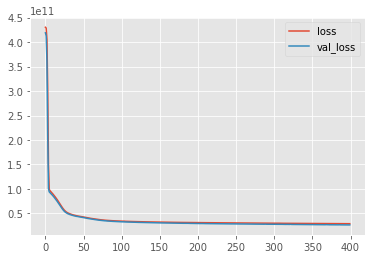

In [57]:
losses.plot()

## Model Evalutaion and Predictions

In [58]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score

In [59]:
predictions = model.predict(X_test)

In [60]:
predictions

array([[404448.1 ],
       [600165.75],
       [577461.8 ],
       ...,
       [384904.28],
       [558252.75],
       [687317.1 ]], dtype=float32)

In [61]:
mean_squared_error(y_test, predictions)

26637914232.143192

In [62]:
np.sqrt(mean_squared_error(y_test, predictions))

163211.25645047645

In [63]:
mean_absolute_error(y_test, predictions)

101550.07783203125

In [65]:
df['price'].describe()

count    2.159700e+04
mean     5.402966e+05
std      3.673681e+05
min      7.800000e+04
25%      3.220000e+05
50%      4.500000e+05
75%      6.450000e+05
max      7.700000e+06
Name: price, dtype: float64

In [66]:
5.402966e+05

540296.6

In [67]:
explained_variance_score(y_test, predictions)

0.7994100923281158

_% 79.9 variance can be explained by the actual model_

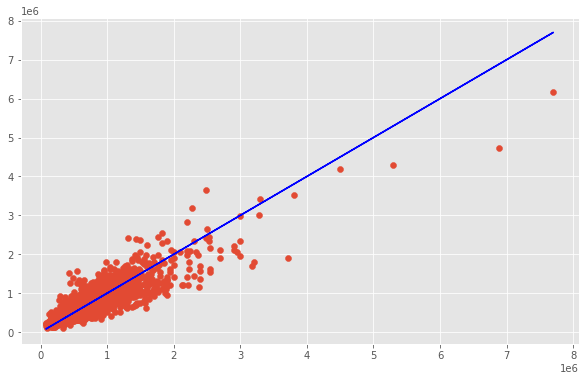

In [69]:
plt.figure(figsize=(10,6))
plt.scatter(y_test, predictions)
plt.plot(y_test, y_test, 'b');

In [70]:
df.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,year,month
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,47.5112,-122.257,1340,5650,2014,10
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,47.7210,-122.319,1690,7639,2014,12
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,47.7379,-122.233,2720,8062,2015,2
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,47.5208,-122.393,1360,5000,2014,12
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,47.6168,-122.045,1800,7503,2015,2


**Taking first row, dropping price value, making prediction**

In [71]:
single_house = df.drop('price', axis=1).loc[0]

In [72]:
single_house

bedrooms            3.0000
bathrooms           1.0000
sqft_living      1180.0000
sqft_lot         5650.0000
floors              1.0000
waterfront          0.0000
view                0.0000
condition           3.0000
grade               7.0000
sqft_above       1180.0000
sqft_basement       0.0000
yr_built         1955.0000
yr_renovated        0.0000
lat                47.5112
long             -122.2570
sqft_living15    1340.0000
sqft_lot15       5650.0000
year             2014.0000
month              10.0000
Name: 0, dtype: float64

In [74]:
single_house.values

array([ 3.00000e+00,  1.00000e+00,  1.18000e+03,  5.65000e+03,
        1.00000e+00,  0.00000e+00,  0.00000e+00,  3.00000e+00,
        7.00000e+00,  1.18000e+03,  0.00000e+00,  1.95500e+03,
        0.00000e+00,  4.75112e+01, -1.22257e+02,  1.34000e+03,
        5.65000e+03,  2.01400e+03,  1.00000e+01])

In [75]:
single_house.values.reshape(-1,19)

array([[ 3.00000e+00,  1.00000e+00,  1.18000e+03,  5.65000e+03,
         1.00000e+00,  0.00000e+00,  0.00000e+00,  3.00000e+00,
         7.00000e+00,  1.18000e+03,  0.00000e+00,  1.95500e+03,
         0.00000e+00,  4.75112e+01, -1.22257e+02,  1.34000e+03,
         5.65000e+03,  2.01400e+03,  1.00000e+01]])

In [76]:
scaler.transform(single_house.values.reshape(-1,19))

array([[0.2       , 0.08      , 0.08376422, 0.00310751, 0.        ,
        0.        , 0.        , 0.5       , 0.4       , 0.10785619,
        0.        , 0.47826087, 0.        , 0.57149751, 0.21760797,
        0.16193426, 0.00582059, 0.        , 0.81818182]])

In [77]:
single_house = scaler.transform(single_house.values.reshape(-1,19))

In [78]:
model.predict(single_house)

array([[287476.84]], dtype=float32)

_Predicted price is 287476_

In [79]:
df.head(1)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,year,month
0,221900.0,3,1.0,1180,5650,1.0,0,0,3,7,1180,0,1955,0,47.5112,-122.257,1340,5650,2014,10


_Actual price is 221900. It seem model overshot around 6K._

<br>

<br>

<br>

**_This notebook is part of "Python for Data Science and Machine Learning Bootcamp" Udemy Course by Jose Portilla._**